## Uncertainty Quantification for the Energy Offshore application

Energy offshore application computes climatological wind and sea ice statistics, and looks at the likelihood of exceeding certain limits that need to be accounted for when working offshore. We also employ the weather window concept and look at the likelihood of not exceeding the given limits for 3-7 consecutive days. This notebook uses the NEMO-IFS historical ensemble for the years 1990-2015 to assess the uncertainties of the model output, and IFS-NEMO and IFS-FESOM SSP3-7.0 to assess the robustness of future trends. In terms of the bias, we compare the model results to the ERA5 reanalysis for the historical period, and to the output from three CMIP6 models (CMCC-CM2-SR5, IPSL-CM6A-LR, and MPI-ESM1-2-HR) for the (2015-2050) future period using the SSP3-7.0 (CMIP6 models were selected based on data availability on DestinE platform). The focus of the use case is on the North eastern North Atlantic and the Baltic Sea.

### Summary - based on the analysis below

In general the bias between IFS-NEMO and ERA5 is small in terms of the likelihood of encountering 10-25 m/s strong winds at the surface. However, there are some interesting differences, for example, IFS-NEMO consistently shows that it is less likely to have weaker than 10 m/s winds close to the Norwegian west coast - this is likely due to the better represented resolution that allows stronger winds closer to the coast. In terms of stronger winds, IFS-NEMO in general shows that they are more frequent (less likely to have winds below the limits) in the Norwegian sea and in the northern North Sea. The pattern is similar in terms of weather windows, but then the signal of persistent strong winds extends also into the Baltic Sea.

In terms of the ensemble spread, for the stronger winds the spread is largest for winter months in the Norwegian Sea and the North Sea and low in summer. In terms of exceeding 10 m/s the the spread of the climatological likelihood is largest during summer, more evenly spread over summer months. However, in terms of 3-day weather windows, the largest uncertainty (ensemble spread) appears during summer in the Baltic Sea.

Taken altogther, the model results appear to be reasonable with little bias and the largest uncertainties related to the strong winds in the Nordic Seas/Northern North Sea, and the weakest winds in the Baltic Sea.

In [1]:
# load packages
import xarray as xr
import glob
import matplotlib.pyplot as plt
from pathlib import Path
import os
# https://github.com/conda-forge/esmf-feedstock/issues/91
os.environ['ESMFMKFILE'] = str(Path(os.__file__).parent.parent / 'esmf.mk')
import xesmf as xe
import esmpy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import from_levels_and_colors
import numpy as np
from scipy.ndimage import gaussian_filter
from scipy.stats import theilslopes
import matplotlib.path as path

#
levelsDiff=np.array([-50,-30,-15,-10,-5,-2.5,-1,1,2.5,5,10,15,30,50])
cmap0=plt.get_cmap('RdBu_r')
cmlist=[];
for cl in np.linspace(0,252,len(levelsDiff)+1): cmlist.append(int(cl))
cmapDiff, normDiff = from_levels_and_colors(levelsDiff,cmap0(cmlist),extend='both');

projection1=ccrs.NearsidePerspective(central_longitude=19.5,central_latitude=59,
                                     satellite_height=1400E3,
                                    )
def theilslopes_helper(y):
    '''Helper function that returns theilslopes output in an array'''
    results=theilslopes(y)
    return np.array([results.slope, results.intercept, results.low_slope, results.high_slope])

ERROR 1: PROJ: proj_create_from_database: Open of /srv/conda/envs/notebook/share/proj failed


In [67]:
era_path='/pfs/lustrep3/scratch/project_465000454/nummelin/ERA5/output/'
limits=['Installation_limit_wind','Service_limit_high_wind','Service_limit_storm_wind','Production_stop']
clim_limit_titles=['Climatological fraction of time with <10 m/s surface winds',
                       'Climatological fraction of time with <18 m/s surface winds',
                       'Climatological fraction of time with <21 m/s surface winds',
                       'Climatological fraction of time with <25 m/s surface winds',
                      ]
ww_limit_titles=['Climatological fraction of time with <10 m/s surface winds for 3 consecutive days',
                       'Climatological fraction of time with <18 m/s surface winds for 3 consecutive  days',
                       'Climatological fraction of time with <21 m/s surface winds for 3 consecutive days',
                       'Climatological fraction of time with <25 m/s surface winds for 3 consecutive  days',
                      ]

In [64]:
# LOAD ENSEMBLE MEMBERS
clim={}
eclim={}
ww={}
for limit in limits:
    print(limit)
    for en in range(1,4):
        ifs_nemo_path='/pfs/lustrep3/scratch/project_465000454/nummelin/IFS-NEMO_hist_En'+str(en)+'_1990_2014/'
        clim['IFSNEMO_'+str(en)+'_'+limit]  = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_climatology_years_*.nc')),combine='nested',concat_dim='year')
        eclim['IFSNEMO_'+str(en)+'_'+limit] = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_extreme_climatology_years_*.nc')),combine='nested',concat_dim='year')
        ww['IFSNEMO_'+str(en)+'_'+limit]    = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_weather_windows_years_*.nc')),combine='nested',concat_dim='year')
    clim['ERA5_'+limit]     = xr.open_mfdataset(sorted(glob.glob(era_path+limit+'_climatology_years_*.nc')),combine='nested',concat_dim='year')
    eclim['ERA5_'+limit]    = xr.open_mfdataset(sorted(glob.glob(era_path+limit+'_extreme_climatology_years_*.nc')),combine='nested',concat_dim='year')
    ww['ERA5_'+limit]       = xr.open_mfdataset(sorted(glob.glob(era_path+limit+'_weather_windows_years_*.nc')),combine='nested',concat_dim='year')

Installation_limit_wind
Service_limit_high_wind
Service_limit_storm_wind
Production_stop


In [65]:
# make regridded to get ERA5 to IFS-NEMO grid
lon_IFSNEMO=xr.DataArray(clim['IFSNEMO_1_'+limit].lon.values, dims='x',name='lon').to_dataset(name='lon')
lat_IFSNEMO=xr.DataArray(clim['IFSNEMO_1_'+limit].lat.values, dims='y',name='lat').to_dataset(name='lat')
grid_IFSNEMO=xr.merge([lon_IFSNEMO,lat_IFSNEMO])
lon_ERA5=xr.DataArray(clim['ERA5_'+limit].lon.values, dims='x',name='lon').to_dataset(name='lon')
lat_ERA5=xr.DataArray(clim['ERA5_'+limit].lat.values, dims='y',name='lat').to_dataset(name='lat')
grid_ERA5=xr.merge([lon_ERA5,lat_ERA5])
ERA5_IFSNEMO=xe.Regridder(grid_ERA5,grid_IFSNEMO,method='bilinear',periodic=True)

In [66]:
lat_min=float(lat_IFSNEMO.lat.min().values)
lat_max=float(lat_IFSNEMO.lat.max().values)
lon_min=float(lon_IFSNEMO.lon.min().values)
lon_max=float(lon_IFSNEMO.lon.max().values)
boundary=path.Path(np.array([[lon_min,lon_max,lon_max,lon_min],[lat_min,lat_min,lat_max,lat_max]]).T).interpolated(20)

## MEAN BIAS

Here we asses the mean bias against ERA5.

Installation_limit_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696:

Service_limit_high_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696:

Service_limit_storm_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:

Production_stop


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions (

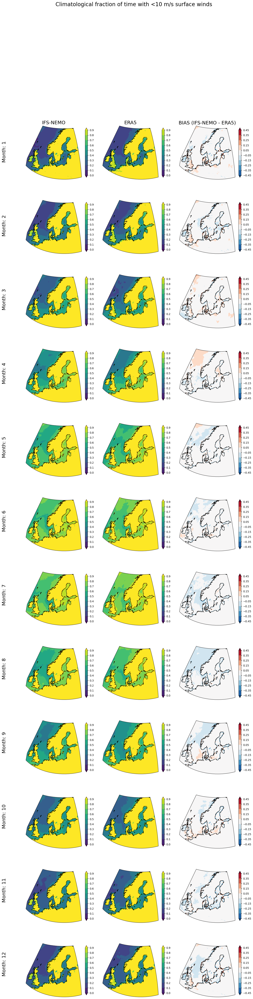

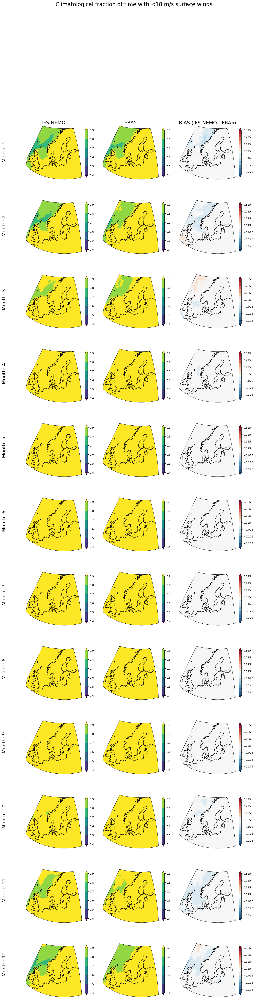

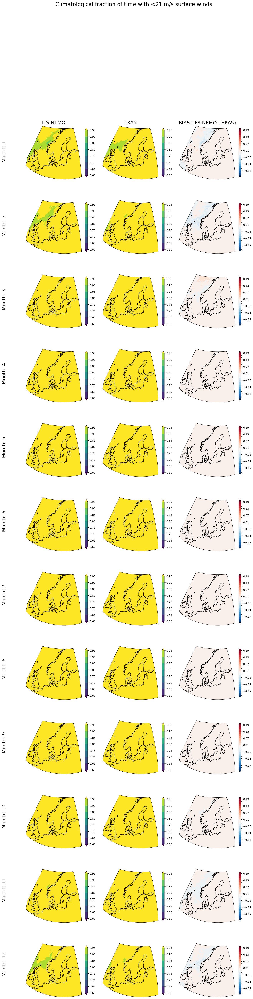

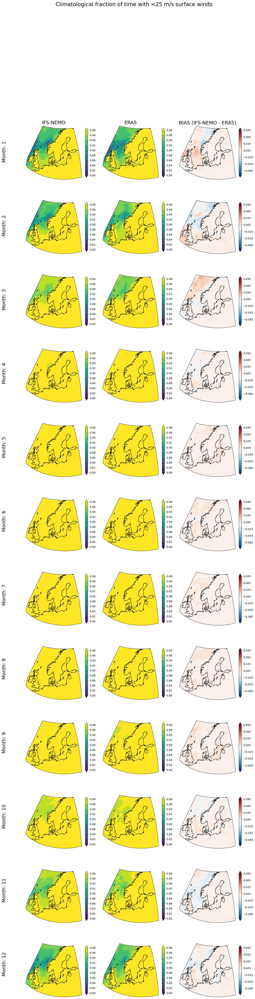

In [72]:
lon2,lat2=np.meshgrid(clim['IFSNEMO_1_'+limit][limit].lon,clim['IFSNEMO_1_'+limit][limit].lat)
ny,nx=lon2.shape
#
for l,limit in enumerate(limits):
    print(limit)
    fig2,axes2=plt.subplots(ncols=3,nrows=12,figsize=(5*3,5*12),subplot_kw={'projection':projection1})
    fig2.suptitle('Ensemble spread/Ensemble mean: '+ limit)
    bounds=[clim['IFSNEMO_1_'+limit][limit].lon.min(),clim['IFSNEMO_1_'+limit][limit].lon.max(),clim['IFSNEMO_1_'+limit][limit].lat.min(),clim['IFSNEMO_1_'+limit][limit].lat.max()]
    for a in range(12):
        # mean of the ensemble members
        clim_dum = xr.concat([clim['IFSNEMO_1_'+limit][limit].isel(month=a).mean('year'),
                              clim['IFSNEMO_2_'+limit][limit].isel(month=a).mean('year'),
                              clim['IFSNEMO_3_'+limit][limit].isel(month=a).mean('year')],dim='ens').mean('ens').rename({'lon':'x','lat':'y'}).assign_coords({'lon':lon_IFSNEMO.lon,'lat':lat_IFSNEMO.lat})
        # regrid ERA5
        ERA5_dum=ERA5_IFSNEMO(clim['ERA5_'+limit][limit].isel(month=a).mean('year')).assign_coords({'lon':lon_IFSNEMO.lon,'lat':lat_IFSNEMO.lat})
        # plot
        levelsL=np.arange([0,0.4,0.6,0.8][l],1,[0.1,0.1,0.05,0.02][l])
        levelsD=np.arange([-0.45,-0.325,-0.21,-0.105][l],[0.5,0.35,0.21,0.105][l],[0.1,0.05,0.02,0.01][l])
        clim_dum.where(clim_dum<1,other=0.99).plot(ax=axes2[a,0],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsL,transform=ccrs.PlateCarree())
        ERA5_dum.where(ERA5_dum<1,other=0.99).plot(ax=axes2[a,1],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsL,transform=ccrs.PlateCarree())
        (clim_dum.where(clim_dum<1,other=0.99)-ERA5_dum.where(ERA5_dum<1,other=0.99)).plot(ax=axes2[a,2],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsD,transform=ccrs.PlateCarree())
    fig2.suptitle(clim_limit_titles[l],fontsize=20)
    axes2[0,0].set_title('IFS-NEMO',fontsize=18)
    axes2[0,1].set_title('ERA5',fontsize=18)
    axes2[0,2].set_title('BIAS (IFS-NEMO - ERA5)',fontsize=18)
    for ax in axes2.flatten():
        ax.coastlines()
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    for a in range(12):
        fig2.text(0.05,0.85-0.064*a,'Month: '+str(a+1),fontsize=18,rotation='vertical',va='center',ha='center')
    fig2.subplots_adjust(hspace=0.05,wspace=0.1)


Installation_limit_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696:

Service_limit_high_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696:

Service_limit_storm_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:

Production_stop


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Production_stop as the horizontal dimensions for the regridding.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions (

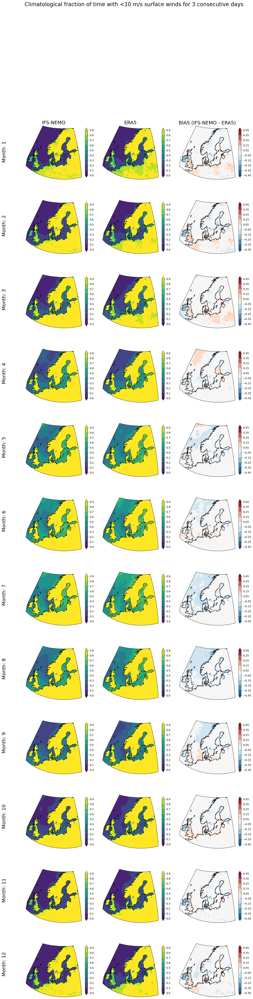

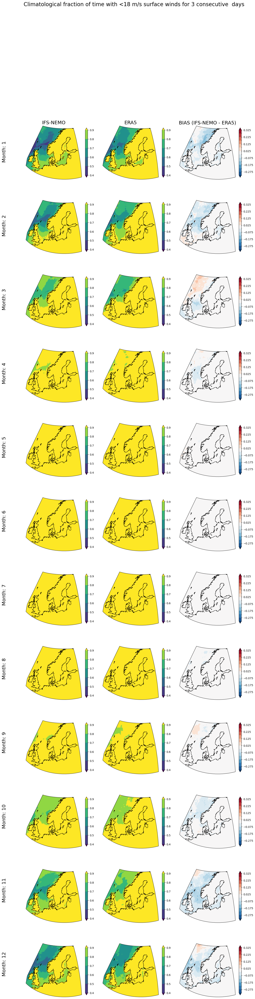

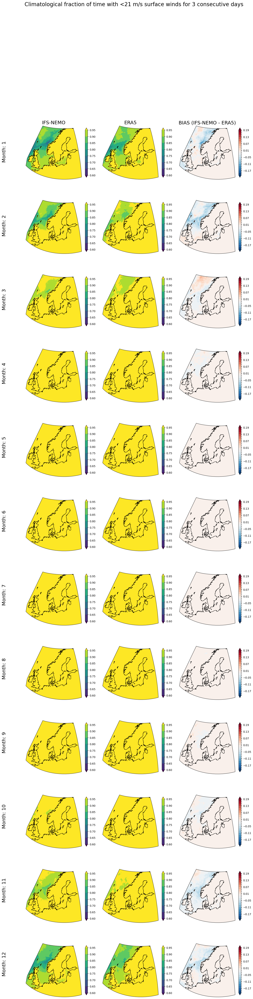

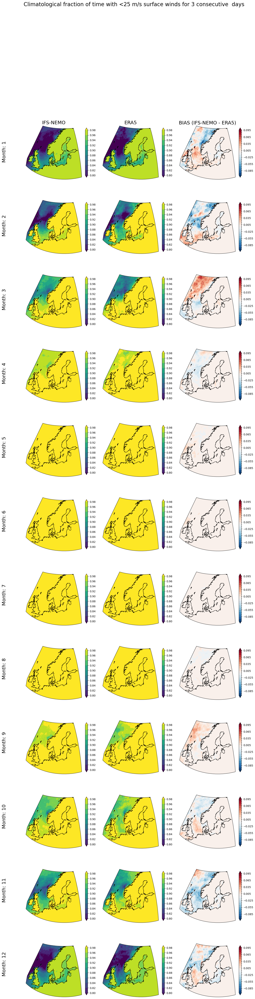

In [73]:
lon2,lat2=np.meshgrid(clim['IFSNEMO_1_'+limit][limit].lon,clim['IFSNEMO_1_'+limit][limit].lat)
ny,nx=lon2.shape
#
for l,limit in enumerate(limits):
    print(limit)
    fig2,axes2=plt.subplots(ncols=3,nrows=12,figsize=(5*3,5*12),subplot_kw={'projection':projection1})
    fig2.suptitle('Ensemble spread/Ensemble mean: '+ limit)
    bounds=[clim['IFSNEMO_1_'+limit][limit].lon.min(),clim['IFSNEMO_1_'+limit][limit].lon.max(),clim['IFSNEMO_1_'+limit][limit].lat.min(),clim['IFSNEMO_1_'+limit][limit].lat.max()]
    for a in range(12):
        ww_dum = xr.concat([ww['IFSNEMO_1_'+limit][limit].isel(month=a,windows=0).mean('year'),
                              ww['IFSNEMO_2_'+limit][limit].isel(month=a,windows=0).mean('year'),
                              ww['IFSNEMO_3_'+limit][limit].isel(month=a,windows=0).mean('year')],dim='ens').mean('ens').rename({'lon':'x','lat':'y'}).assign_coords({'lon':lon_IFSNEMO.lon,'lat':lat_IFSNEMO.lat})
        ERA5_dum=ERA5_IFSNEMO(ww['ERA5_'+limit][limit].isel(month=a,windows=0).mean('year')).assign_coords({'lon':lon_IFSNEMO.lon,'lat':lat_IFSNEMO.lat})
        # plot
        levelsL=np.arange([0,0.4,0.6,0.8][l],1,[0.1,0.1,0.05,0.02][l])
        levelsD=np.arange([-0.45,-0.325,-0.21,-0.105][l],[0.5,0.35,0.21,0.105][l],[0.1,0.05,0.02,0.01][l])
        ww_dum.plot(ax=axes2[a,0],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsL,transform=ccrs.PlateCarree())
        ERA5_dum.plot(ax=axes2[a,1],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsL,transform=ccrs.PlateCarree())
        (ww_dum-ERA5_dum).plot(ax=axes2[a,2],x='lon', y='lat',add_labels=False,cbar_kwargs={'shrink':0.7},extend='both',levels=levelsD,transform=ccrs.PlateCarree())
    fig2.suptitle(ww_limit_titles[l],fontsize=20)
    axes2[0,0].set_title('IFS-NEMO',fontsize=18)
    axes2[0,1].set_title('ERA5',fontsize=18)
    axes2[0,2].set_title('BIAS (IFS-NEMO - ERA5)',fontsize=18)
    for ax in axes2.flatten():
        ax.coastlines()
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    for a in range(12):
        fig2.text(0.05,0.85-0.064*a,'Month: '+str(a+1),fontsize=18,rotation='vertical',va='center',ha='center')
    fig2.subplots_adjust(hspace=0.05,wspace=0.1)


## Ensemble spread

Here we assess the robustness of the results in terms of the ensemble spread. If the ensemble spread is small compared to the mean then there is little uncertainty, however, it the spread is large then the mean is not a robust estimator.

Installation_limit_wind
Service_limit_high_wind
Service_limit_storm_wind
Production_stop


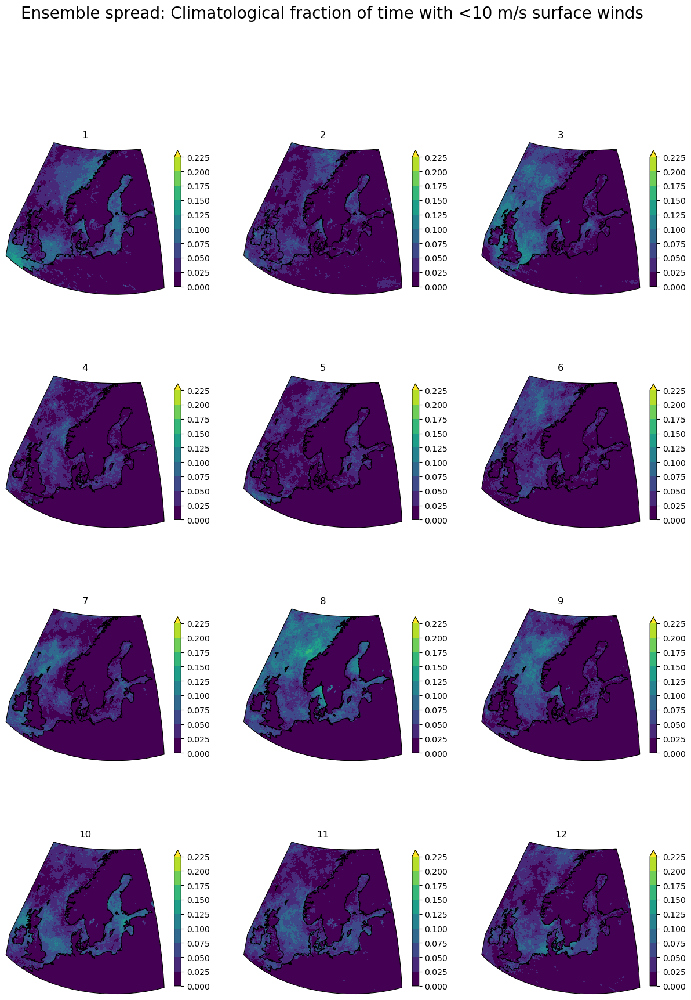

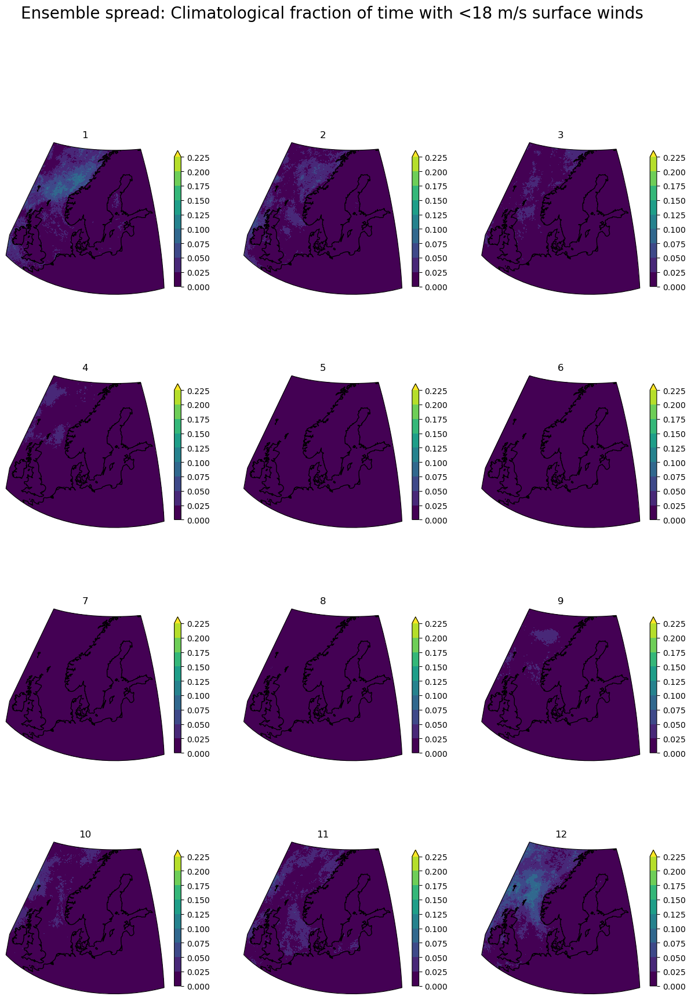

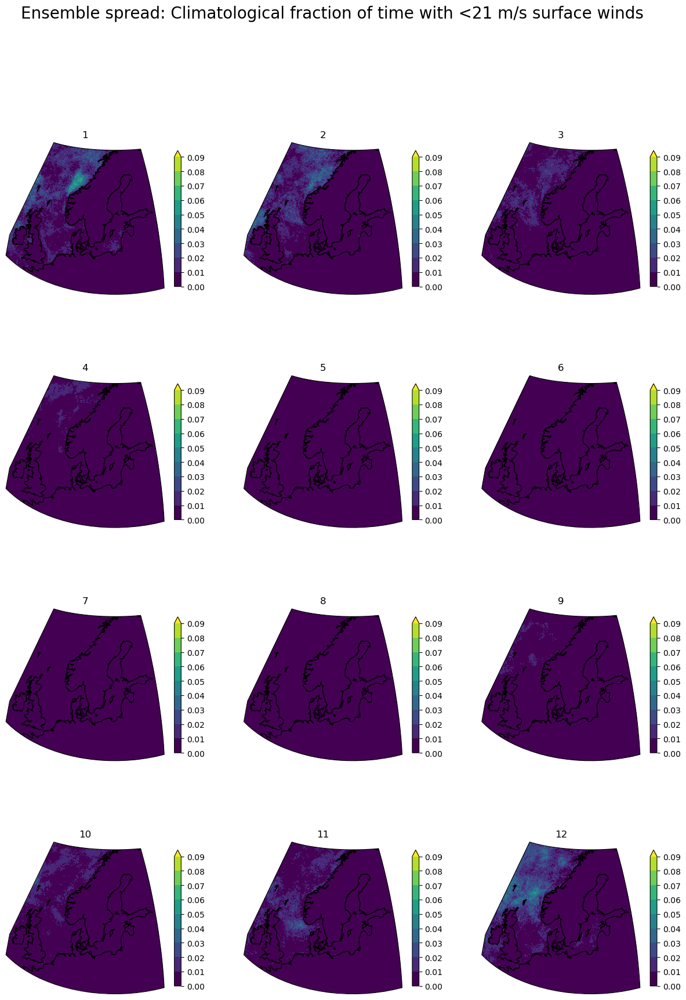

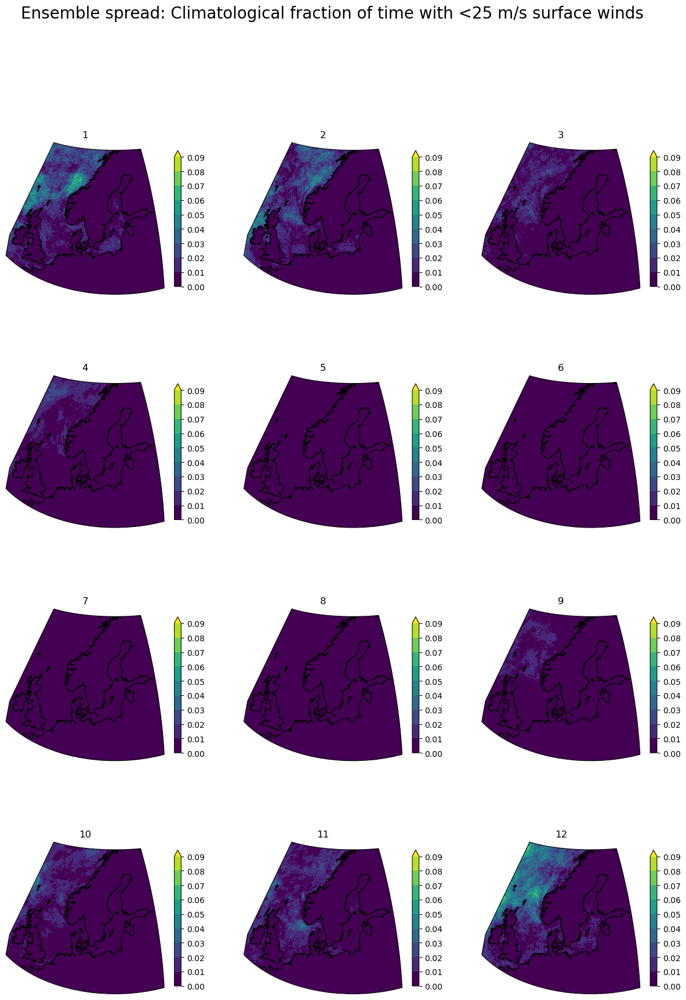

In [74]:
## ENSEMBLE SPREAD OF THE CLIMATOLOGICAL MEAN FRACTION OF TIME GIVEN CONDITIONS ARE MET

lon2,lat2=np.meshgrid(clim['IFSNEMO_1_'+limit][limit].lon,clim['IFSNEMO_1_'+limit][limit].lat)
ny,nx=lon2.shape
#
for l,limit in enumerate(limits):
    print(limit)
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('Ensemble spread: '+ clim_limit_titles[l],fontsize=20)
    bounds=[clim['IFSNEMO_1_'+limit][limit].lon.min(),clim['IFSNEMO_1_'+limit][limit].lon.max(),clim['IFSNEMO_1_'+limit][limit].lat.min(),clim['IFSNEMO_1_'+limit][limit].lat.max()]
    for a,ax in enumerate(axes2.flatten()):
        # SINCE WE DON'T YET HAVE AN ENSEMBLE WE CREATE IT HERE
        dum = xr.concat([clim['IFSNEMO_1_'+limit][limit].isel(month=a).mean('year'),
                         clim['IFSNEMO_2_'+limit][limit].isel(month=a).mean('year'),
                         clim['IFSNEMO_3_'+limit][limit].isel(month=a).mean('year')],dim='ens')
        # THE FOLLOWING APPLIES ALSO AFTER WE ACTUALLY HAVE THE ENSEMBLE
        dum_range=dum.max('ens')-dum.min('ens')
        dum_mean=dum.mean('ens')
        #(dum_range/abs(dum_mean)).plot(ax=ax,x='lon',y='lat',transform=ccrs.PlateCarree(),levels=np.arange(0.0,[0.7,0.6,0.5,0.4][l],[0.1,0.1,0.05,0.05][l]),
        #                                                                                        cbar_kwargs={'shrink':0.7})
        dum_range.plot(ax=ax,x='lon',y='lat',transform=ccrs.PlateCarree(),levels=np.arange(0.0,[0.25,0.25,0.1,0.1][l],[0.025,0.025,0.01,0.01][l]),
                                                                                                cbar_kwargs={'shrink':0.7},add_labels=False,extend='max')
        ax.set_title(str(a+1))
    for ax in axes2.flatten():
        ax.coastlines()
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    #for a in range(12):
    #    fig2.text(0.05,0.85-0.064*a,'Month: '+str(a+1),fontsize=18,rotation='vertical',va='center',ha='center')

Installation_limit_wind
Service_limit_high_wind
Service_limit_storm_wind
Production_stop


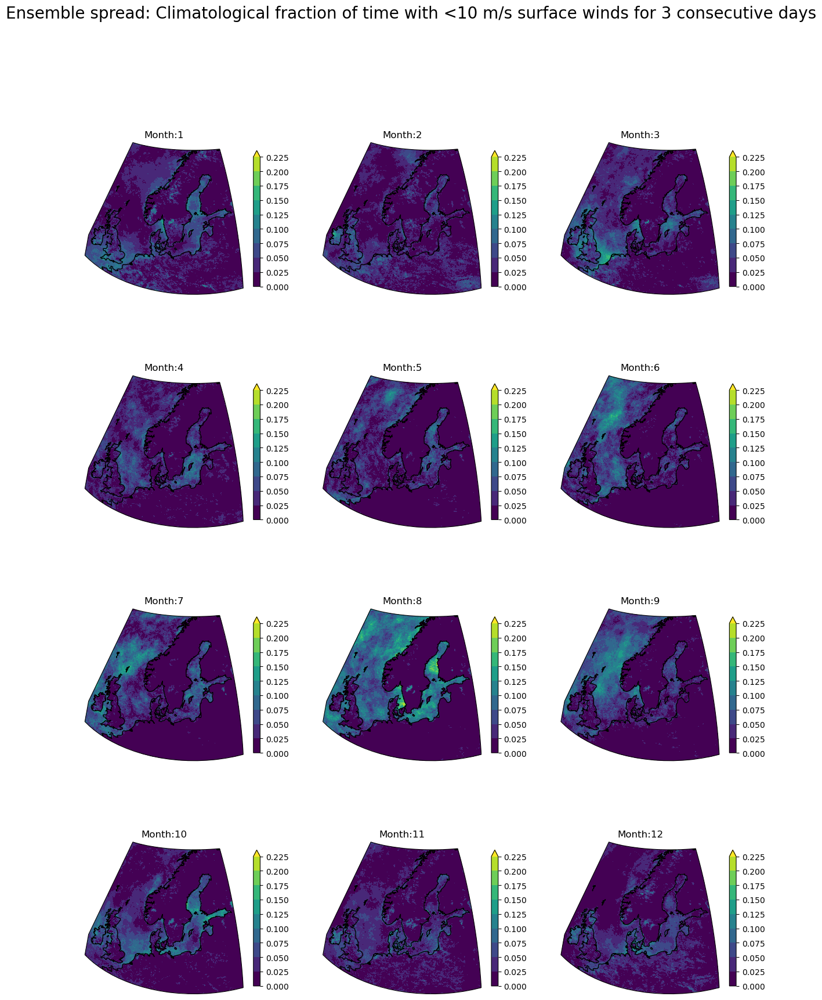

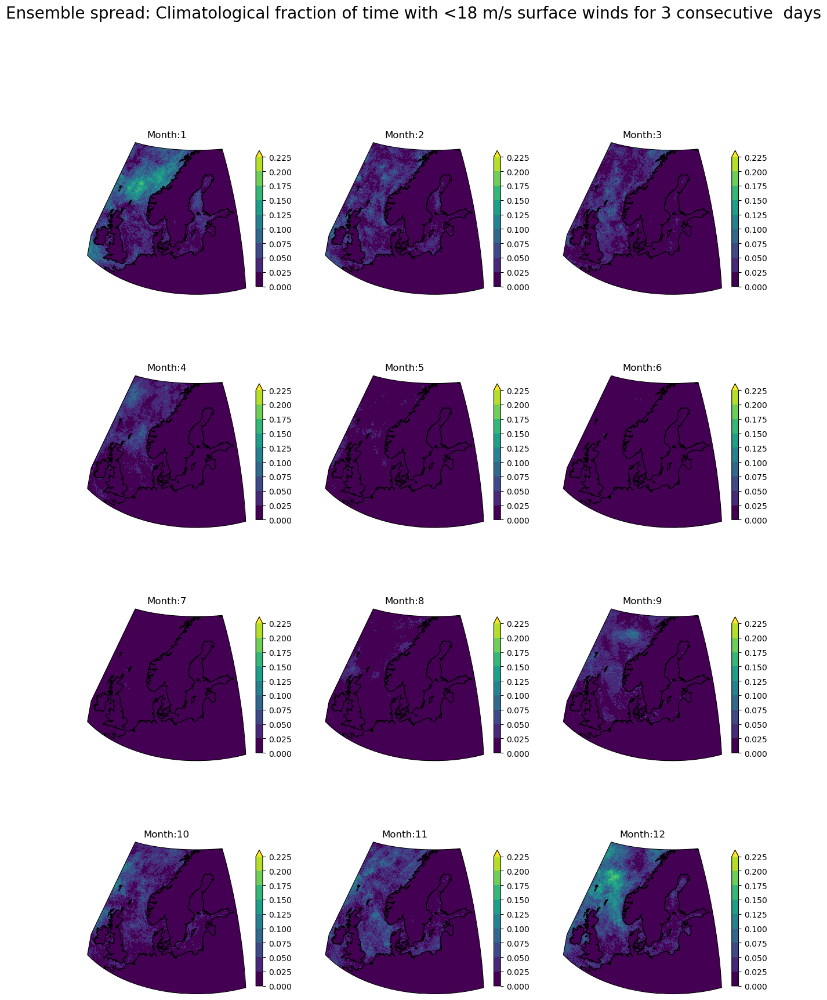

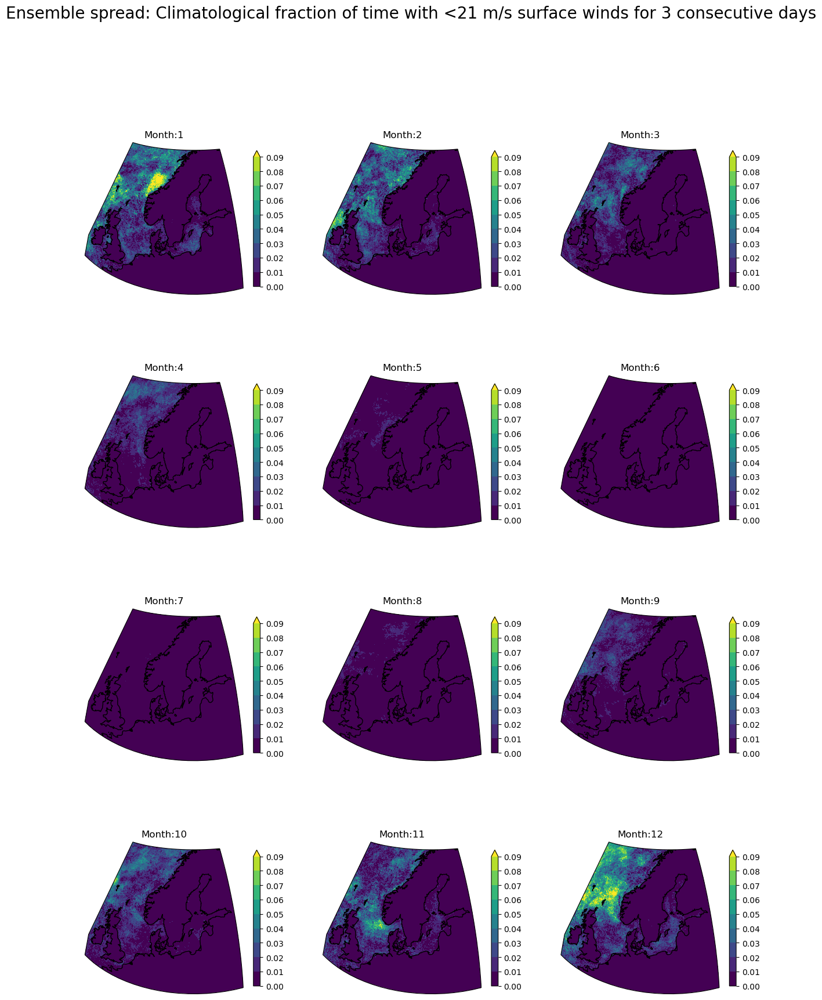

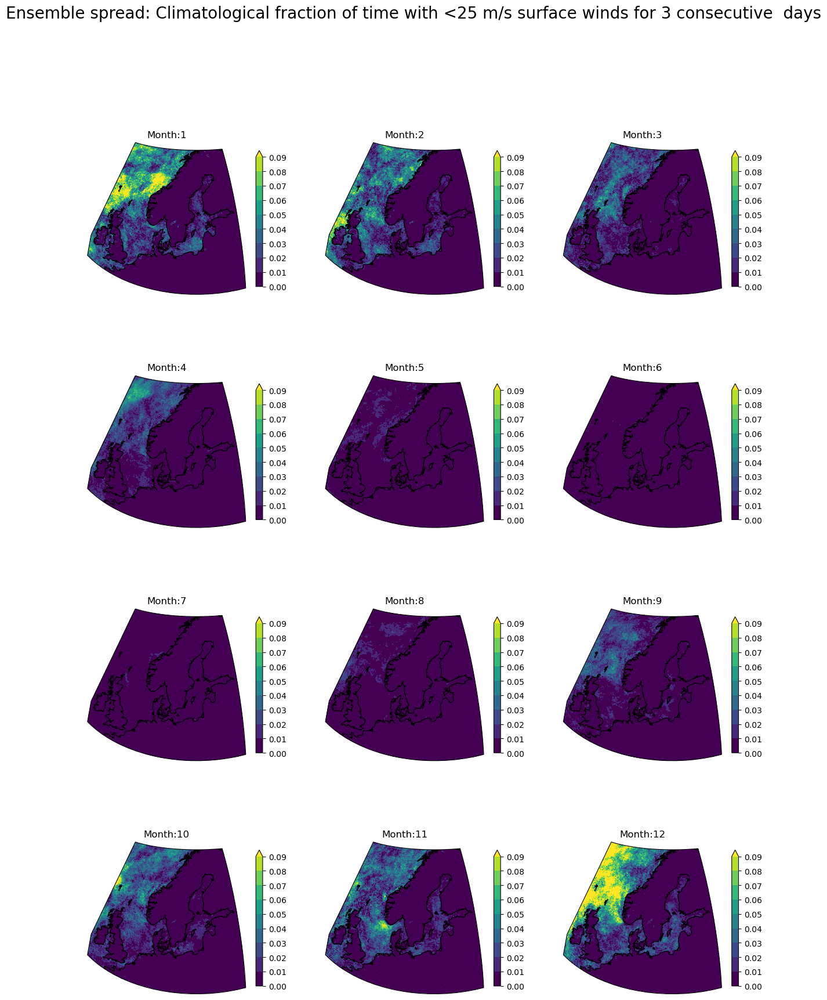

In [75]:
## ENSEMBLE SPREAD OF THE CLIMATOLOGICAL MEAN FRACTION OF TIME GIVEN CONDITIONS ARE MET 3 CONSECUTIVE DAYS IN A ROW
lon2,lat2=np.meshgrid(clim['IFSNEMO_1_'+limit][limit].lon,clim['IFSNEMO_1_'+limit][limit].lat)
ny,nx=lon2.shape
#
for l,limit in enumerate(limits):
    print(limit)
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('Ensemble spread: '+ ww_limit_titles[l],fontsize=20)
    bounds=[clim['IFSNEMO_1_'+limit][limit].lon.min(),clim['IFSNEMO_1_'+limit][limit].lon.max(),clim['IFSNEMO_1_'+limit][limit].lat.min(),clim['IFSNEMO_1_'+limit][limit].lat.max()]
    for a,ax in enumerate(axes2.flatten()):
        # SINCE WE DON'T YET HAVE AN ENSEMBLE WE CREATE IT HERE
        dum = xr.concat([ww['IFSNEMO_1_'+limit][limit].isel(month=a,windows=0).mean('year'),
                         ww['IFSNEMO_2_'+limit][limit].isel(month=a,windows=0).mean('year'),
                         ww['IFSNEMO_3_'+limit][limit].isel(month=a,windows=0).mean('year')],dim='ens')
        # THE FOLLOWING APPLIES ALSO AFTER WE ACTUALLY HAVE THE ENSEMBLE
        dum_range=dum.max('ens')-dum.min('ens')
        dum_mean=dum.mean('ens')
        #(dum_range/abs(dum_mean)).plot(ax=ax,x='lon',y='lat',transform=ccrs.PlateCarree(),levels=np.arange(0.0,[0.7,0.6,0.5,0.4][l],[0.1,0.1,0.05,0.05][l]),
        #                                                                                        cbar_kwargs={'shrink':0.7})
        #dum_range.plot(ax=ax,x='lon',y='lat',transform=ccrs.PlateCarree(),levels=np.arange(0.0,[0.25,0.25,0.1,0.1][l],[0.05,0.05,0.01,0.01][l]),
        #                                                                                        cbar_kwargs={'shrink':0.7})
        dum_range.plot(ax=ax,x='lon',y='lat',transform=ccrs.PlateCarree(),levels=np.arange(0.0,[0.25,0.25,0.1,0.1][l],[0.025,0.025,0.01,0.01][l]),
                                                                                                cbar_kwargs={'shrink':0.7},add_labels=False,extend='max')
        ax.set_title('Month:'+str(a+1))
    for ax in axes2.flatten():
        ax.coastlines()
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    #for a in range(12):
    #    fig2.text(0.05,0.85-0.064*a,'Month: '+str(a+1),fontsize=18,rotation='vertical',va='center',ha='center')

# SSP3-7.0 analysis

Here we look at trends in monthly exceedance frequency and weather windows. Note that the exceedance frequency is measured as in 'time within bounds', i.e. if frequency is 0 the variable is out of bounds every day of the month, and if frequency is 1 then the bounds are never crossed. This implies that a positive trend implies less frequent crossing of the bound, whereas negative trend implies more frequent crossing of the bound.

In [151]:
compute_slopes=False #this takes time so better to use False if it has been done already
cases={'o00k':{'model':'IFS-FESOM','scenario':'SSP3.5','years':range(2015,2022)},
       'o010':{'model':'IFS-NEMO','scenario':'SSP3.5','years':range(2015,2040)},
       'o00q':{'model':'ICON','scenario':'SSP3.5','years':range(2015,2040)}
      }
casepath='/pfs/lustrep3/scratch/project_465000454/nummelin/from_LUMIO/output/'
#
for limit in limits:
    print(limit)
    for case in list(cases.keys())[1:]:
        print(case)
        ifs_nemo_path=casepath+case+'/'
        clim[case+'_'+limit]  = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_climatology_years_*.nc')),combine='nested',concat_dim='year')[limit]
        eclim[case+'_'+limit] = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_extreme_climatology_years_*.nc')),combine='nested',concat_dim='year')[limit]
        ww[case+'_'+limit]    = xr.open_mfdataset(sorted(glob.glob(ifs_nemo_path+limit+'_weather_windows_years_*.nc')),combine='nested',concat_dim='year')[limit]

Installation_limit_wind
o010
o00q
Service_limit_high_wind
o010
o00q
Service_limit_storm_wind
o010
o00q
Production_stop
o010
o00q


In [154]:
case=list(cases.keys())[1]
lon_IFSNEMO=xr.DataArray(clim[case+'_'+limit].lon.values, dims='x',name='lon').to_dataset(name='lon')
lat_IFSNEMO=xr.DataArray(clim[case+'_'+limit].lat.values, dims='y',name='lat').to_dataset(name='lat')
#
lat_min=float(lat_IFSNEMO.lat.min().values)
lat_max=float(lat_IFSNEMO.lat.max().values)
lon_min=float(lon_IFSNEMO.lon.min().values)
lon_max=float(lon_IFSNEMO.lon.max().values)
#
lon2,lat2=np.meshgrid(lon_IFSNEMO.lon,lat_IFSNEMO.lat)
lon2=xr.DataArray(lon2,dims=('lat','lon'))
lat2=xr.DataArray(lat2,dims=('lat','lon'))
ny,nx=lon2.shape
#
bounds=[lon_min,lon_max,lat_min,lat_max]
boundary=path.Path(np.array([[lon_min,lon_max,lon_max,lon_min],[lat_min,lat_min,lat_max,lat_max]]).T).interpolated(20)

In [164]:
#
slopes={}
if compute_slopes:
    for l,limit in enumerate(limits):
        print(limit)
        dum = xr.concat([clim[list(cases.keys())[1]+'_'+limit].isel(year=slice(0,20)).chunk(dict(year=-1,month=1)),
                     clim[list(cases.keys())[2]+'_'+limit].isel(year=slice(0,20)).chunk(dict(year=-1,month=1))],dim='case')
        # this could be done for all months at once
        slopes[limit] =xr.apply_ufunc(theilslopes_helper,dum,
                               input_core_dims=[['year']],
                               output_core_dims=[['dum']],
                               vectorize=True,
                               dask="parallelized",
                               output_dtypes=[np.float32],
                               dask_gufunc_kwargs={'output_sizes':{'dum':4}}
                              ).compute()
        slopes[limit].to_dataset(name=limit).to_netcdf('DestinE_SSP3-7.0_'+limit+'_clim.nc')
else:
    for l,limit in enumerate(limits):
        print(limit)
        slopes[limit] = xr.open_dataset('DestinE_SSP3-7.0_'+limit+'_clim.nc')[limit]

Installation_limit_wind
Service_limit_high_wind
Service_limit_storm_wind
Production_stop


In [165]:
WWslopes={}
if compute_slopes:
    for l,limit in enumerate(limits):
        print(limit)
        dum = xr.concat([ww[list(cases.keys())[1]+'_'+limit].isel(year=slice(0,20)).chunk(dict(year=-1,month=1)),
                         ww[list(cases.keys())[2]+'_'+limit].isel(year=slice(0,20)).chunk(dict(year=-1,month=1))],dim='case')
        #
        WWslopes[limit] =xr.apply_ufunc(theilslopes_helper,dum,
                               input_core_dims=[['year']],
                               output_core_dims=[['dum']],
                               vectorize=True,
                               dask="parallelized",
                               output_dtypes=[np.float32],
                               dask_gufunc_kwargs={'output_sizes':{'dum':4}}
                              ).compute()
        WWslopes[limit].to_dataset(name=limit).to_netcdf('DestinE_SSP3-7.0_'+limit+'_ww.nc')
else:
    for l,limit in enumerate(limits):
        print(limit)
        WWslopes[limit]=xr.open_dataset('DestinE_SSP3-7.0_'+limit+'_ww.nc')[limit]

Installation_limit_wind
Service_limit_high_wind
Service_limit_storm_wind
Production_stop


Installation_limit_wind
0
1
2
3
4
5
6
7
8
9
10
11
Service_limit_high_wind
0
1
2
3
4
5
6
7
8
9
10
11
Service_limit_storm_wind
0
1
2
3
4
5
6
7
8
9
10
11
Production_stop
0
1
2
3
4
5
6
7
8
9
10
11


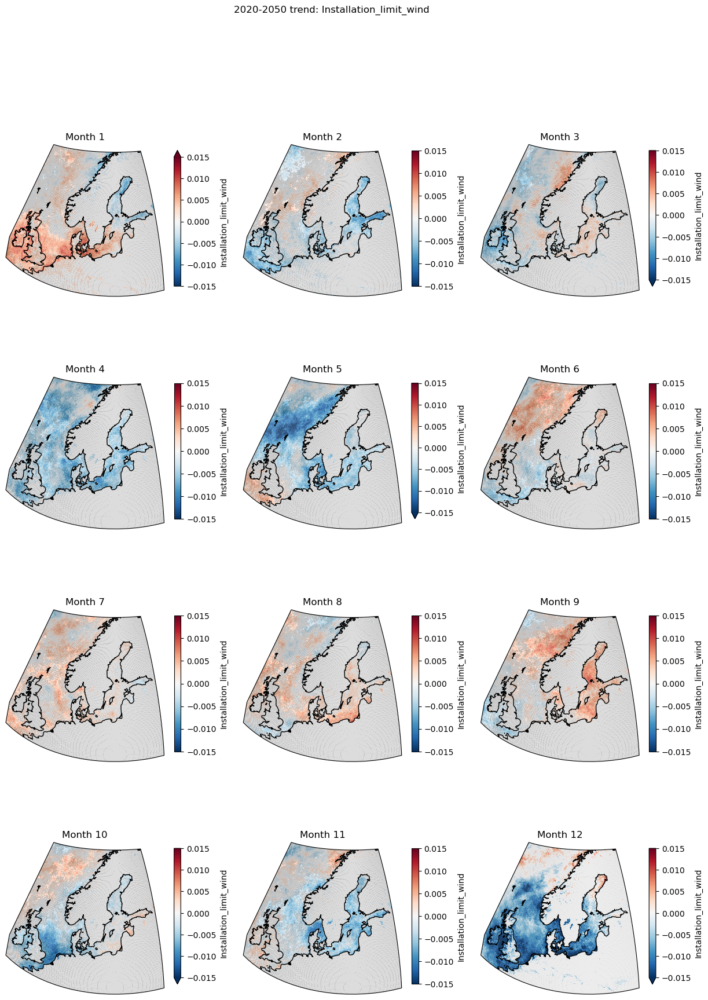

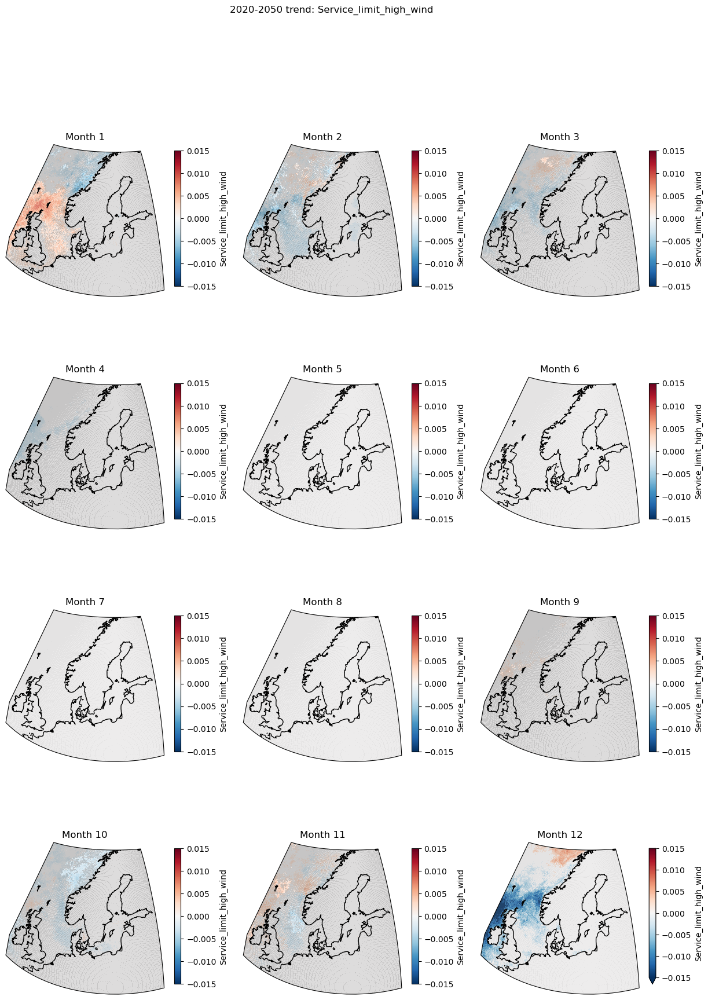

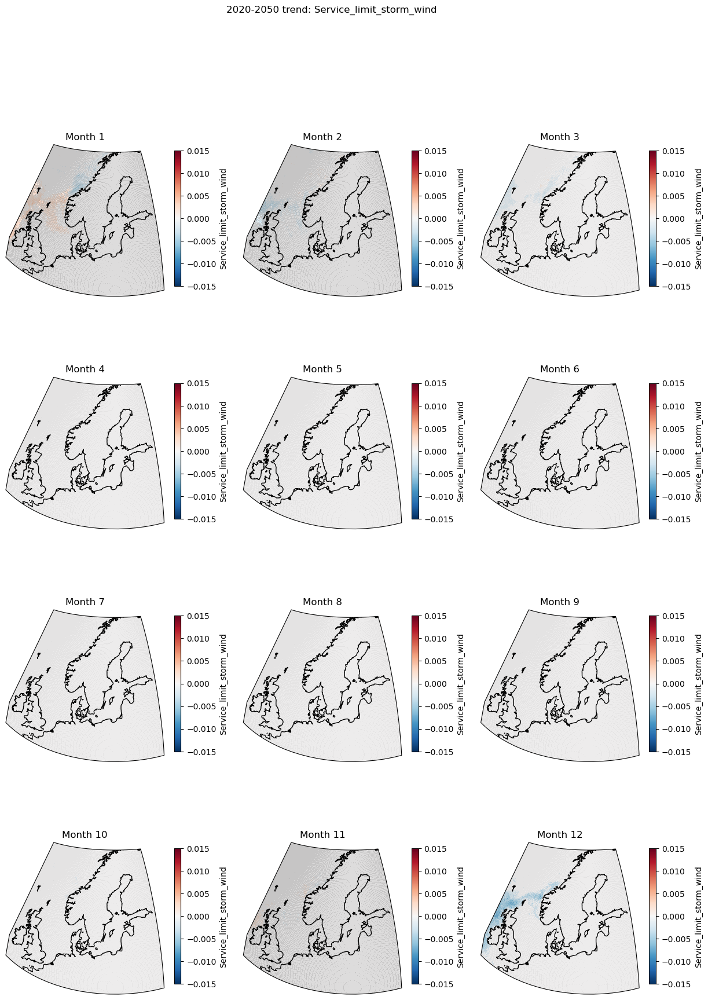

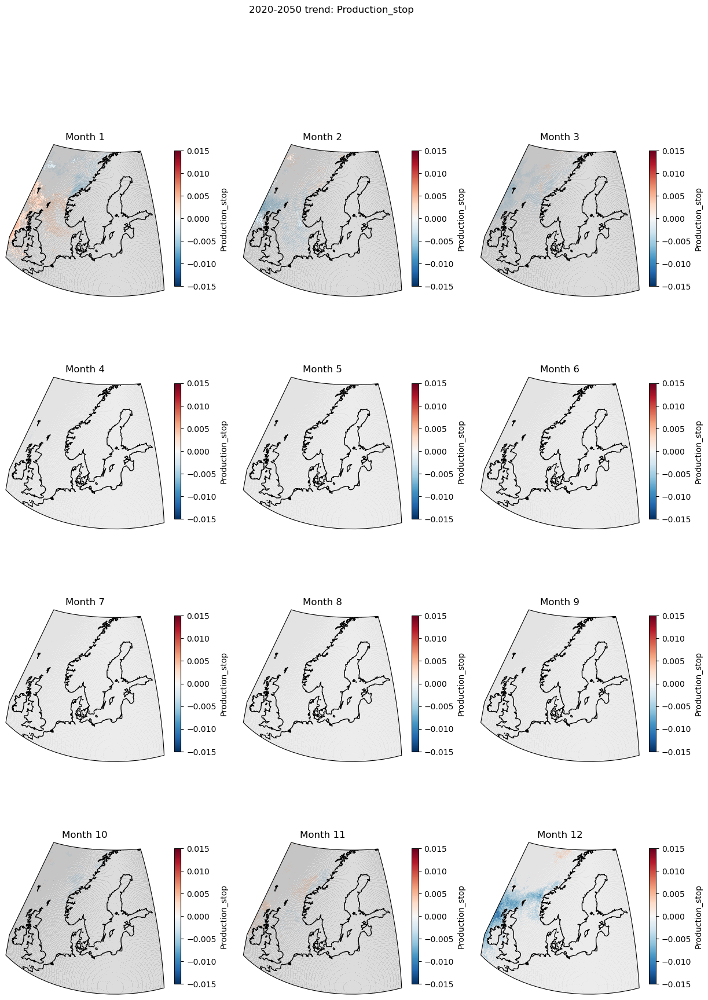

In [167]:
for l,limit in enumerate(limits):
    print(limit)
    # plot a figure
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('2020-2050 trend: '+ limit)
    for a,ax in enumerate(axes2.flatten()):
        print(a)
        # combine data
        # dimension dum includes the theislopes output in the following order: (slope, intercept, low_slope, high_slope)
        # THE FOLLOWING APPLIES ALSO AFTER WE ACTUALLY HAVE THE ENSEMBLE
        agreement_mask=abs(np.sign(slopes[limit].isel(dum=0,month=a)).sum('case')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
        # plot the slope
        slopes[limit].isel(dum=0,month=a).mean('case').plot(ax=ax,vmin=-0.015,vmax=0.015,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),cbar_kwargs={'shrink':0.7})
        agreement_mask.where(agreement_mask<2).notnull().plot(ax=ax,cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
        #
        ax.set_title('Month '+str(a+1))
        ax.coastlines()
        ax.set_extent(bounds, ccrs.PlateCarree())
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())

Installation_limit_wind
0
1
2
3
4
5
6
7
8
9
10
11
Service_limit_high_wind
0
1
2
3
4
5
6
7
8
9
10
11
Service_limit_storm_wind
0
1
2
3
4
5
6
7
8
9
10
11
Production_stop
0
1
2
3
4
5
6
7
8
9
10
11


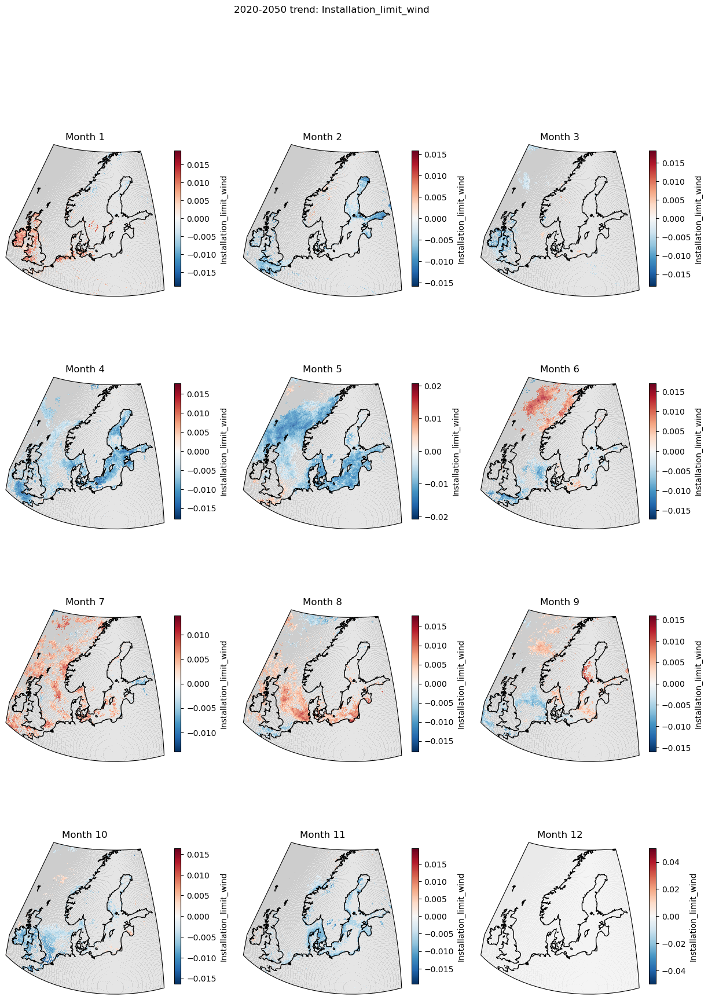

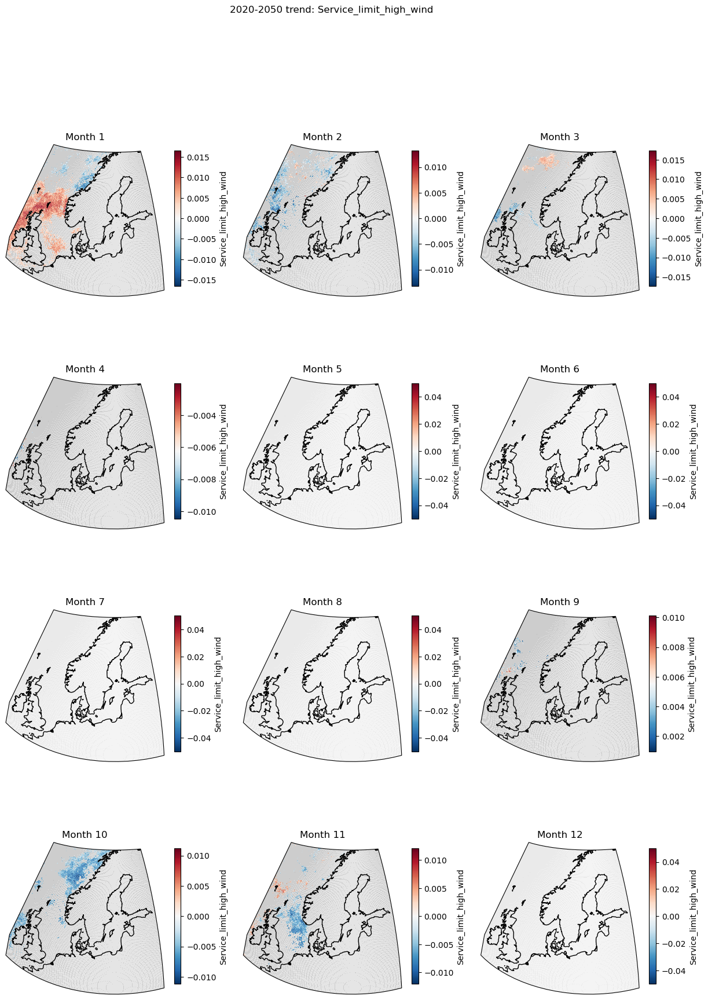

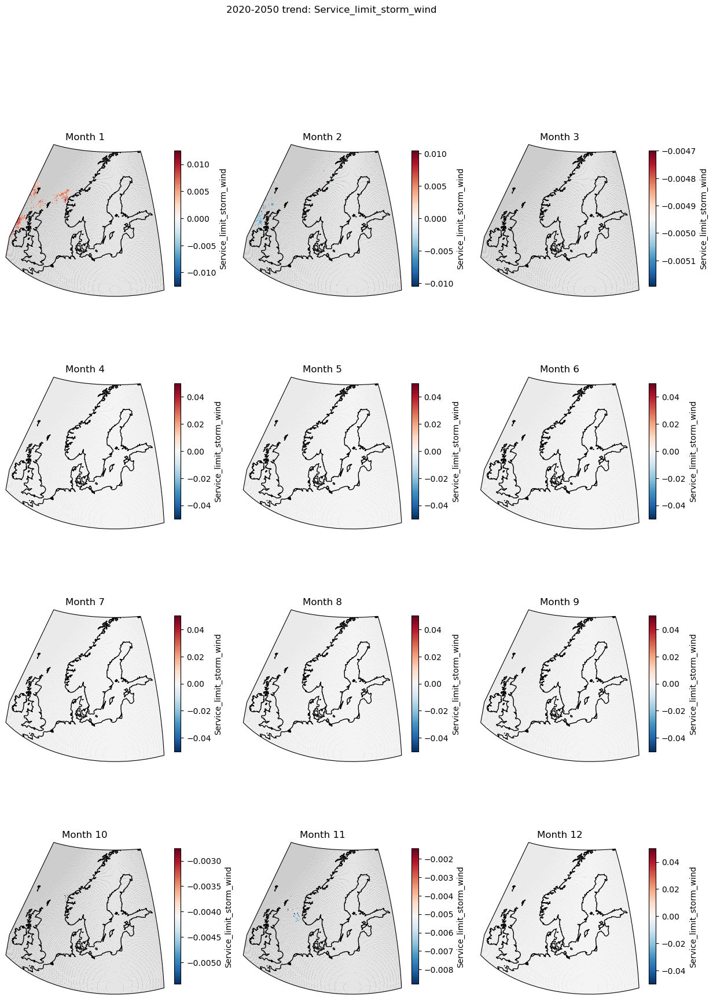

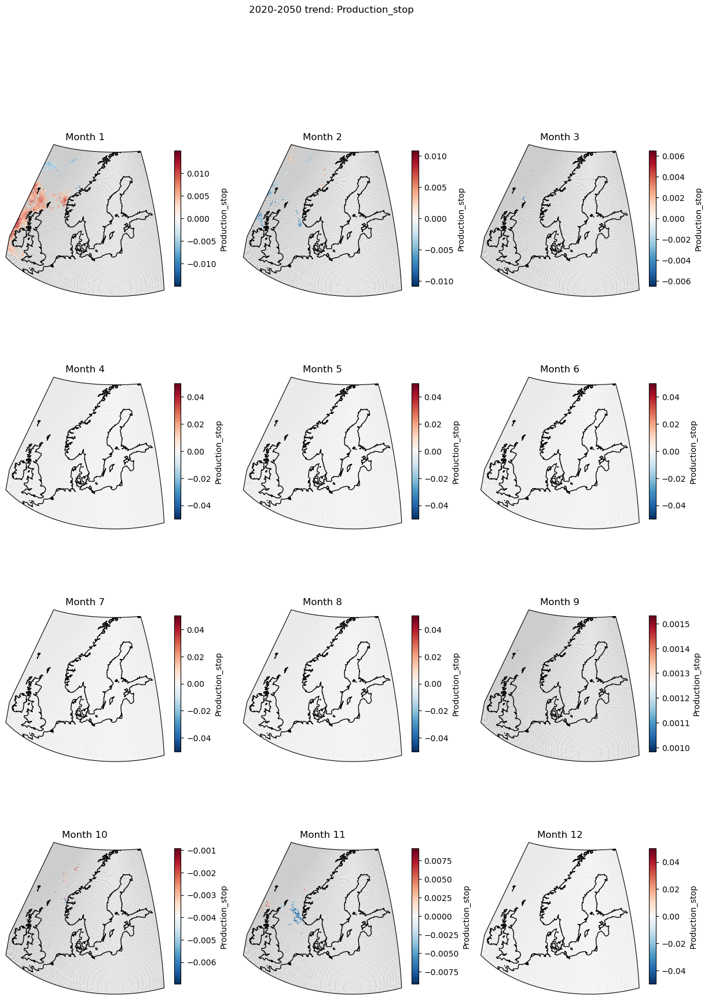

In [168]:
#same as above but for 3-day weather window
for l,limit in enumerate(limits):
    print(limit)
    # plot a figure
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('2020-2050 trend: '+ limit)
    for a,ax in enumerate(axes2.flatten()):
        print(a)
        # combine data
        # dimension dum includes the theislopes output in the following order: (slope, intercept, low_slope, high_slope)
        # THE FOLLOWING APPLIES ALSO AFTER WE ACTUALLY HAVE THE ENSEMBLE
        agreement_mask=abs(np.sign(WWslopes[limit].isel(dum=0,month=a,windows=0)).sum('case')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
        # plot the slope
        WWslopes[limit].isel(dum=0,month=a,windows=0).mean('case').where(agreement_mask==2).plot(ax=ax,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),cbar_kwargs={'shrink':0.7})
        agreement_mask.where(agreement_mask<2).notnull().plot(ax=ax,cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
        ax.set_title('Month '+str(a+1))
        ax.coastlines()
        ax.set_extent(bounds, ccrs.PlateCarree())
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())

# Comparison to CMIP6

In [116]:
models=['CMCC-CM2-SR5','IPSL-CM6A-LR','MPI-ESM1-2-HR']
CMIPslopes={}
CMIPslopesWW={}
for limit in limits[:3]:
    for model in models:
        CMIPslopes[model+limit]=xr.open_dataset('/users/nummelin/'+model+'slopes_climatology_'+limit+'.nc')
        CMIPslopesWW[model+limit]=xr.open_dataset('/users/nummelin/'+model+'slopes_ww_'+limit+'.nc')
    

In [68]:
# regrid all to ERA5 grid
#
limit=limits[0]
lon_ERA5=xr.DataArray(clim['ERA5_'+limit].lon.values, dims='x',name='lon').to_dataset(name='lon')
lat_ERA5=xr.DataArray(clim['ERA5_'+limit].lat.values, dims='y',name='lat').to_dataset(name='lat')
grid_ERA5=xr.merge([lon_ERA5,lat_ERA5])
regridders={}
for model in models:
    print(model)
    lon_model=xr.DataArray(CMIPslopes[model+limit].lon.values, dims='x',name='lon').to_dataset(name='lon')
    lat_model=xr.DataArray(CMIPslopes[model+limit].lat.values, dims='y',name='lat').to_dataset(name='lat')
    grid_model=xr.merge([lon_model,lat_model])
    regridders[model]=xe.Regridder(grid_model,grid_ERA5,method='bilinear',periodic=False,filename=model+'_to_ERA5_regridder.nc')

CMCC-CM2-SR5
IPSL-CM6A-LR
MPI-ESM1-2-HR


Installation_limit_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_high_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_storm_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


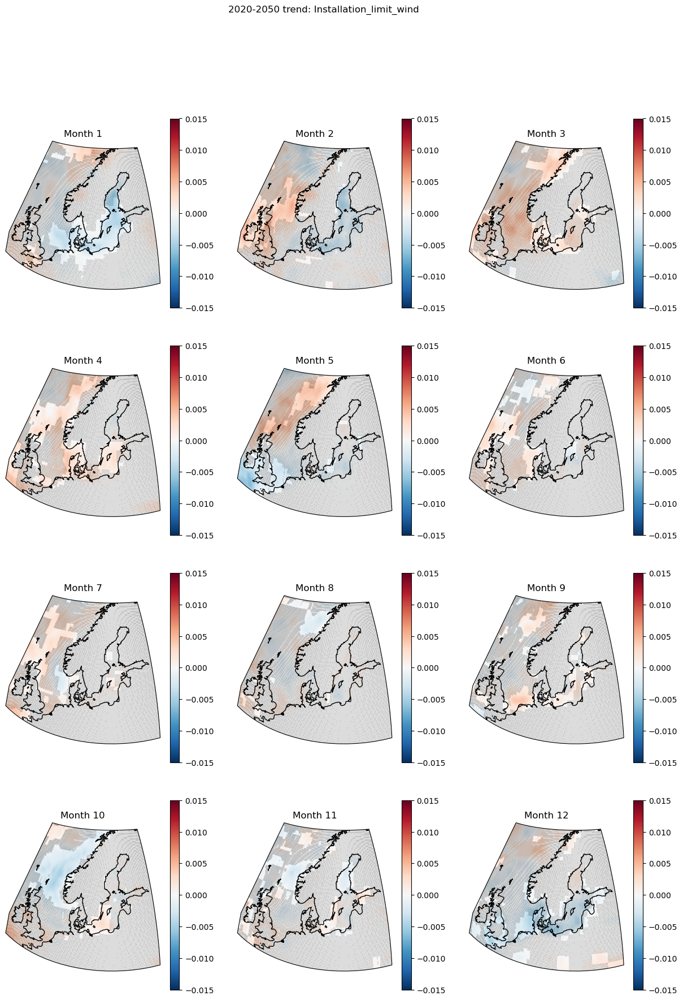

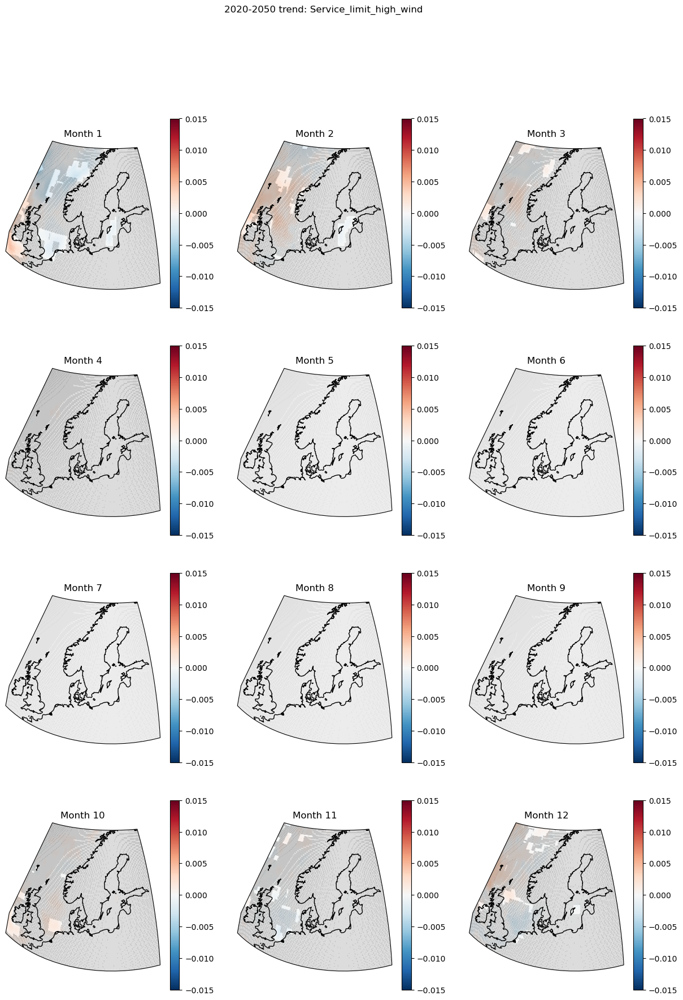

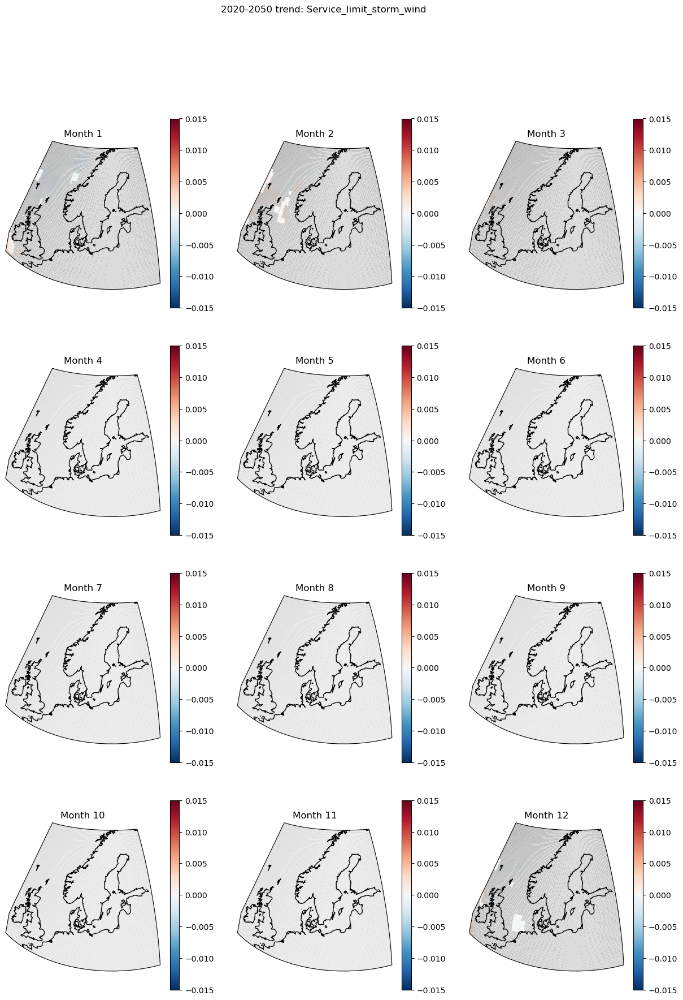

In [160]:
for l,limit in enumerate(limits[:3]):
    print(limit)
    # plot a figure
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('2020-2050 trend: '+ limit)
    for a,ax in enumerate(axes2.flatten()):
        print(a)
        # combine data
        # dimension dum includes the theislopes output in the following order: (slope, intercept, low_slope, high_slope)
        all_slopes = xr.concat([regridders[models[0]](CMIPslopes[models[0]+limit][limit].isel(dum=0,month=a)),
                                regridders[models[1]](CMIPslopes[models[1]+limit][limit].isel(dum=0,month=a)),
                                regridders[models[2]](CMIPslopes[models[2]+limit][limit].isel(dum=0,month=a))],dim='models')
        agreement_mask=abs(np.sign(all_slopes).sum('models')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
        # plot the slope
        #all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).where(agreement_mask==2).plot(ax=ax,vmin=-0.015,vmax=0.015,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
        all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=ax,vmin=-0.015,vmax=0.015,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
        agreement_mask.where(agreement_mask<2).notnull().assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=ax,cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
        ax.set_title('Month '+str(a+1))
        ax.coastlines()
        ax.set_extent(bounds, ccrs.PlateCarree())
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())

Installation_limit_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_high_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_storm_wind
0


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


1


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


2


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


3


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


4


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


5


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


6


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


7


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


8


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


9


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


10


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


11


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


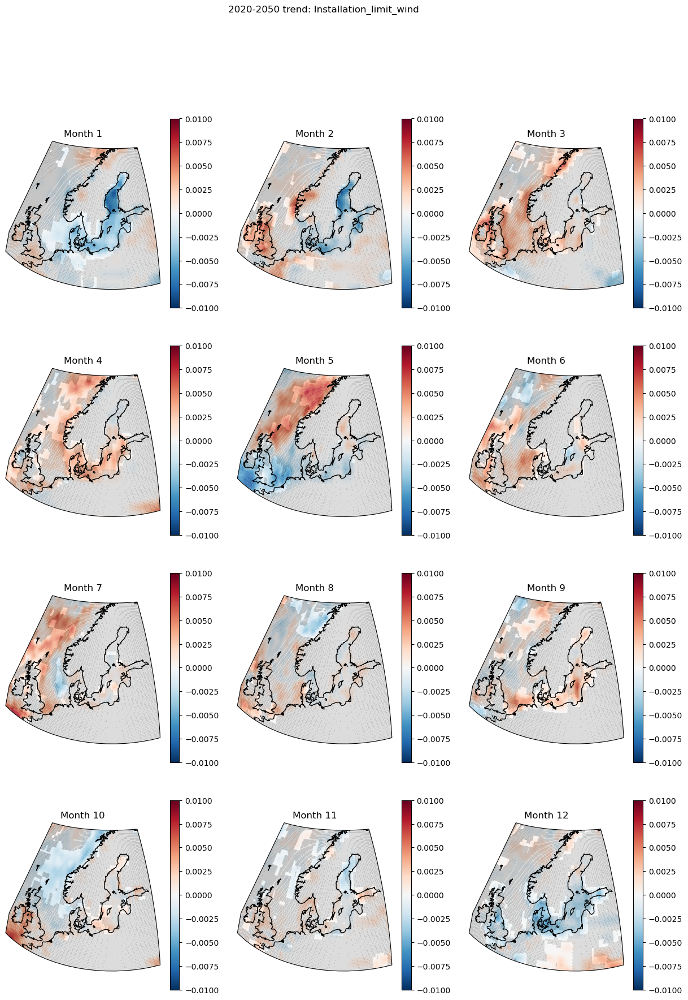

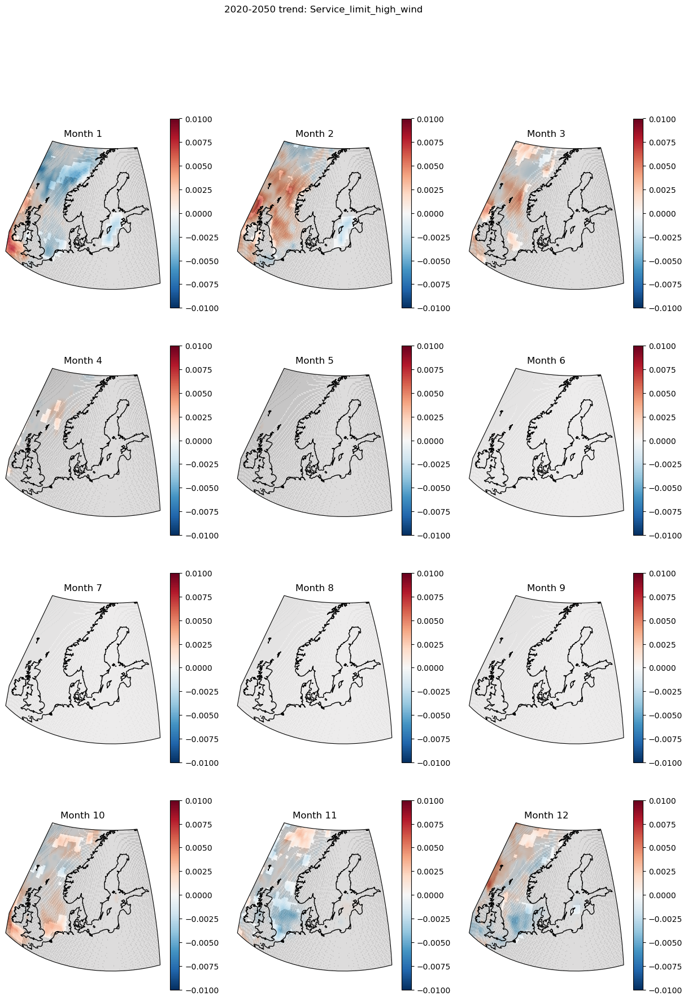

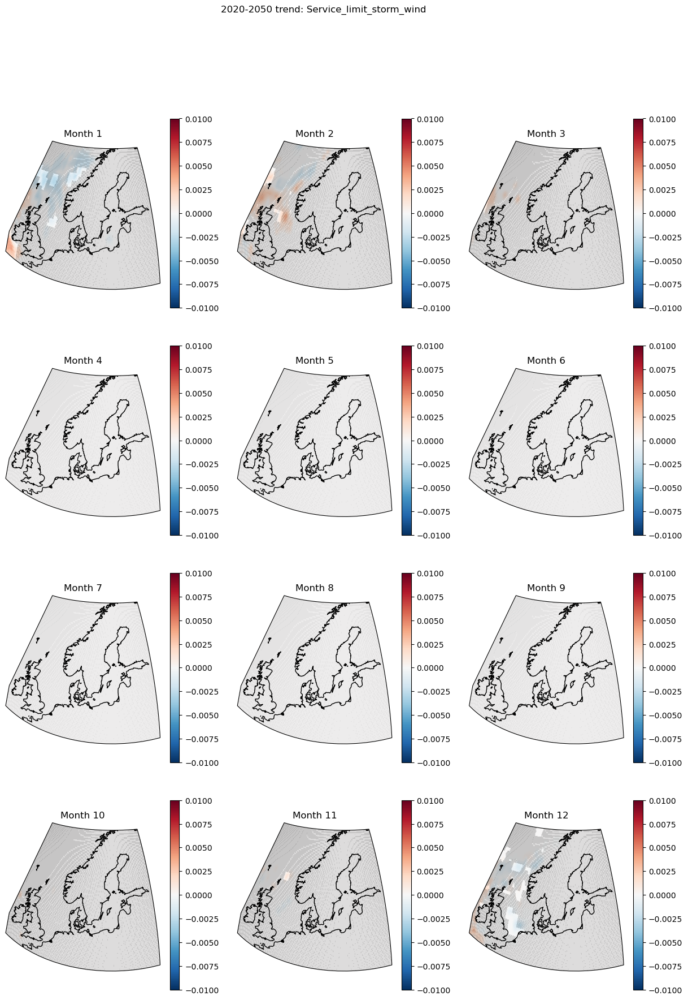

In [161]:
for l,limit in enumerate(limits[:3]):
    print(limit)
    # plot a figure
    fig2,axes2=plt.subplots(ncols=3,nrows=4,figsize=(5*3,5*4),subplot_kw={'projection':projection1})
    fig2.suptitle('2020-2050 trend: '+ limit)
    for a,ax in enumerate(axes2.flatten()):
        print(a)
        # combine data
        # dimension dum includes the theislopes output in the following order: (slope, intercept, low_slope, high_slope)
        all_slopes = xr.concat([regridders[models[0]](CMIPslopesWW[models[0]+limit][limit].isel(dum=0,month=a,windows=0)),
                                regridders[models[1]](CMIPslopesWW[models[1]+limit][limit].isel(dum=0,month=a,windows=0)),
                                regridders[models[2]](CMIPslopesWW[models[2]+limit][limit].isel(dum=0,month=a,windows=0))],dim='models')
        agreement_mask=abs(np.sign(all_slopes).sum('models')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
        # plot the slope
        all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=ax,vmin=-0.01,vmax=0.01,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
        agreement_mask.where(agreement_mask<2).notnull().assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=ax,cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
        #all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=ax,vmin=-0.01,vmax=0.01,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
        ax.set_title('Month '+str(a+1))
        ax.coastlines()
        ax.set_extent(bounds, ccrs.PlateCarree())
        ax.set_boundary(boundary,transform=ccrs.PlateCarree())

# Figure for the deliverable

Installation_limit_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_high_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_storm_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


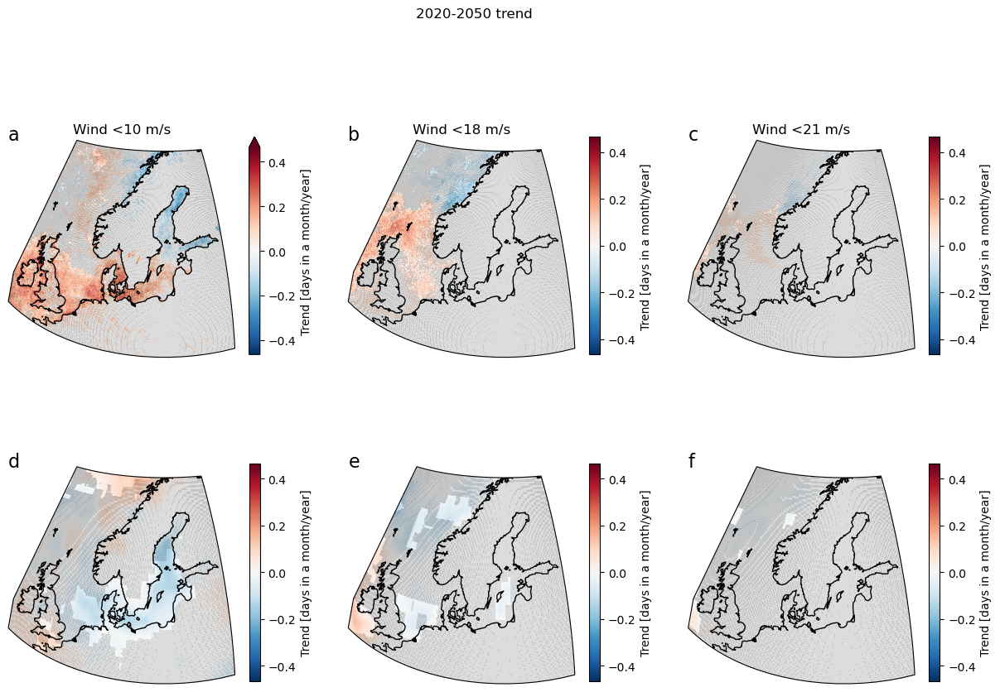

In [148]:
fig2,axes2=plt.subplots(ncols=3,nrows=2,figsize=(3*5,2*5),subplot_kw={'projection':projection1})
fig2.suptitle('2020-2050 trend')
#
a=0 # which month
ndays = 31 #number of days in a month (January) used for unit  conversion
for l,limit in enumerate(limits[:3]):
    print(limit)
    # plot a figure
    # DestinE
    agreement_mask=abs(np.sign(slopes[limit].isel(dum=0,month=a)).sum('case')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
    (ndays*slopes[limit]).isel(dum=0,month=a).mean('case').plot(ax=axes2[0,l],vmin=-0.015*ndays,vmax=0.015*ndays,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),cbar_kwargs={'shrink':0.7,'label':'Trend [days in a month/year]'})
    agreement_mask.where(agreement_mask<2).notnull().plot(ax=axes2[0,l],cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
    axes2[0,l].set_title(['Wind <10 m/s','Wind <18 m/s','Wind <21 m/s'][l])
    # CMIP6
    all_slopes = xr.concat([regridders[models[0]](CMIPslopes[models[0]+limit][limit].isel(dum=0,month=a)),
                            regridders[models[1]](CMIPslopes[models[1]+limit][limit].isel(dum=0,month=a)),
                            regridders[models[2]](CMIPslopes[models[2]+limit][limit].isel(dum=0,month=a))],dim='models')
    agreement_mask=abs(np.sign(all_slopes).sum('models')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
    # plot the slope
    #all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).where(agreement_mask==2).plot(ax=ax,vmin=-0.015,vmax=0.015,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
    (ndays*all_slopes.mean('models')).assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=axes2[1,l],vmin=-0.015*ndays,vmax=0.015*ndays,
                                                                                          cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),
                                                                                          cbar_kwargs={'shrink':0.7,'label':'Trend [days in a month/year]'}
                                                                                         )
    agreement_mask.where(agreement_mask<2).notnull().assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=axes2[1,l],cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
    axes2[1,l].set_title('')
    #ax.plot(lon2.isel(lon=iinds0,lat=jinds0),lat2.isel(lon=iinds0,lat=jinds0),'+',markersize=.1,color='gray',transform=ccrs.PlateCarree())
    #ax.plot(lon2.isel(lon=iinds2,lat=jinds2),lat2.isel(lon=iinds2,lat=jinds2),'.',markersize=.1,color='gray',transform=ccrs.PlateCarree())
    
for a,ax in enumerate(axes2.flatten()):
    ax.coastlines()
    ax.set_extent(bounds, ccrs.PlateCarree())
    ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    ax.text(0,1,string.ascii_lowercase[a],transform=ax.transAxes,fontsize=16)
    #
fig2.subplots_adjust(hspace=0.05)
fig2.savefig('EnergyOffshore_FutureExceedanceStatisticTrends.png', dpi = 300, bbox_inches='tight')

Installation_limit_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Installation_limit_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_high_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_high_wind as the horizontal dimensions for the regridding.
  warnings.warn(


Service_limit_storm_wind


/srv/conda/envs/notebook/lib/python3.11/site-packages/xesmf/frontend.py:696: UserWarning: Using dimensions ('lat', 'lon') from data variable Service_limit_storm_wind as the horizontal dimensions for the regridding.
  warnings.warn(


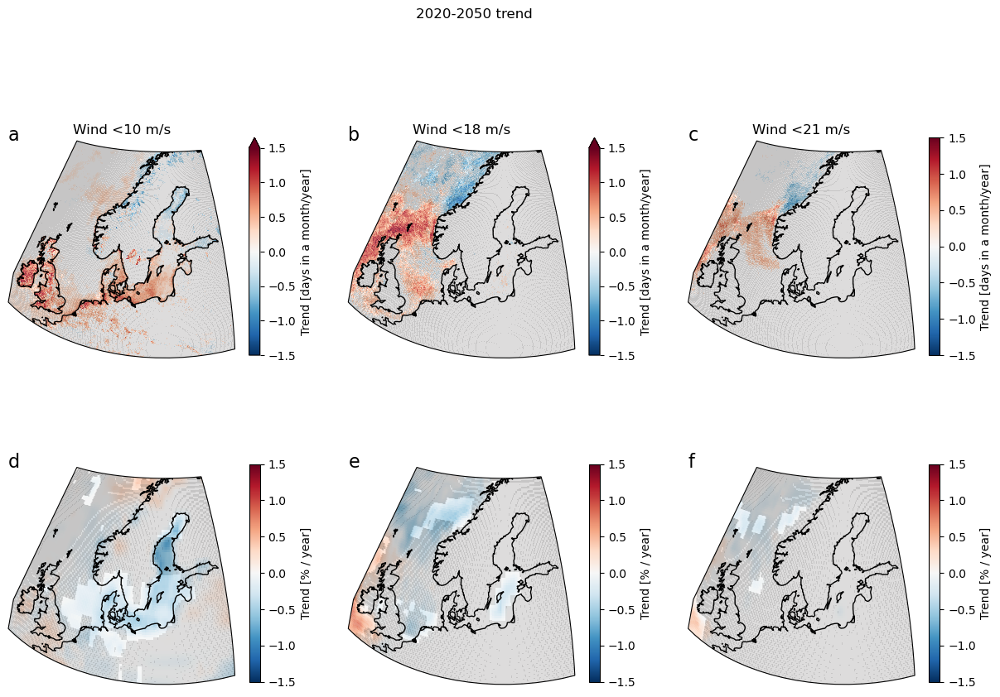

In [149]:
# same as above, but for weather windows
fig2,axes2=plt.subplots(ncols=3,nrows=2,figsize=(3*5,2*5),subplot_kw={'projection':projection1})
fig2.suptitle('2020-2050 trend')
#
a=0 # which month
ndays = 31 #number of days in a month (January) used for unit  conversion
for l,limit in enumerate(limits[:3]):
    print(limit)
    # plot a figure
    # DestinE
    agreement_mask=abs(np.sign(WWslopes[limit].isel(dum=0,month=a,windows=0)).sum('case')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
    (100*WWslopes[limit]).isel(dum=0,month=a,windows=0).mean('case').plot(ax=axes2[0,l],vmin=-0.015*100,vmax=0.015*100,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),cbar_kwargs={'shrink':0.7,'label':'Trend [days in a month/year]'})
    agreement_mask.where(agreement_mask<2).notnull().plot(ax=axes2[0,l],cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
    axes2[0,l].set_title(['Wind <10 m/s','Wind <18 m/s','Wind <21 m/s'][l])
    # CMIP6
    all_slopes = xr.concat([regridders[models[0]](CMIPslopesWW[models[0]+limit][limit].isel(dum=0,month=a,windows=0)),
                            regridders[models[1]](CMIPslopesWW[models[1]+limit][limit].isel(dum=0,month=a,windows=0)),
                            regridders[models[2]](CMIPslopesWW[models[2]+limit][limit].isel(dum=0,month=a,windows=0))],dim='models')
    agreement_mask=abs(np.sign(all_slopes).sum('models')) #3 == all models agree,2 == 2 of the models agree, 1 == models do not agree
    # plot the slope
    #all_slopes.mean('models').assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).where(agreement_mask==2).plot(ax=ax,vmin=-0.015,vmax=0.015,cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree())
    (100*all_slopes.mean('models')).assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=axes2[1,l],vmin=-0.015*100,vmax=0.015*100,
                                                                                          cmap=plt.get_cmap('RdBu_r'),x='lon',y='lat',transform=ccrs.PlateCarree(),
                                                                                          cbar_kwargs={'shrink':0.7,'label':'Trend [% / year]'}
                                                                                         )
    agreement_mask.where(agreement_mask<2).notnull().assign_coords({'lon':lon_ERA5.lon,'lat':lat_ERA5.lat}).plot(ax=axes2[1,l],cmap=plt.get_cmap('Grays'),alpha=0.1,add_colorbar=False,add_labels=False,x='lon',y='lat',transform=ccrs.PlateCarree())
    axes2[1,l].set_title('')
    #ax.plot(lon2.isel(lon=iinds0,lat=jinds0),lat2.isel(lon=iinds0,lat=jinds0),'+',markersize=.1,color='gray',transform=ccrs.PlateCarree())
    #ax.plot(lon2.isel(lon=iinds2,lat=jinds2),lat2.isel(lon=iinds2,lat=jinds2),'.',markersize=.1,color='gray',transform=ccrs.PlateCarree())
    
for a,ax in enumerate(axes2.flatten()):
    ax.coastlines()
    ax.set_extent(bounds, ccrs.PlateCarree())
    ax.set_boundary(boundary,transform=ccrs.PlateCarree())
    ax.text(0,1,string.ascii_lowercase[a],transform=ax.transAxes,fontsize=16)
    #
fig2.subplots_adjust(hspace=0.05)
fig2.savefig('EnergyOffshore_Future3dayWeatherWindowStatisticTrends.png', dpi = 300, bbox_inches='tight')